<a href="https://colab.research.google.com/github/Jose-Augusto-C-M/Pantanal_benchmark_Segmentation/blob/main/SLIC_segmentation%26label_extraction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import cv2
import os
from sklearn.mixture import GaussianMixture as GMM
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, Normalize
from skimage.segmentation import slic
from skimage.color import label2rgb
from skimage import exposure
from skimage.measure import regionprops
from skimage import io
from skimage.transform import resize


In [ ]:
# Define the folder containing the images and the output folders
folder_path = "/content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/"
output_folder = '/content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/'
label_output_folder = '/content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/label_out/'  # New folder for label masks

if not os.path.exists(output_folder):
    os.makedirs(output_folder)

In [ ]:
# SLIC parameters
n_segments = 40  # Number of segments
compactness = 10.0  # Compactness parameter

# Set the maximum number of components for BIC calculation
max_components = 3

In [ ]:
# Function to fit a GMM model to an image
def fit_gmm_model(image, n_components=max_components):
    img2 = image.reshape((-1, 3))
    gmm_model = GMM(n_components=n_components, covariance_type='tied', random_state=0)
    gmm_model.fit(img2)
    return gmm_model

# Function to perform GMM-based image segmentation
def process_image(image, gmm_model):
    gmm_labels = gmm_model.predict(image.reshape((-1, 3)))
    segmented = gmm_labels.reshape(image.shape[0], image.shape[1])
    return segmented

# Function to calculate BIC values for different numbers of components
def calculate_bic(image, max_components=4):
    img2 = image.reshape((-1, 3))
    bic_values = []

    for n_components in range(1, max_components + 1):
        gmm_model = GMM(n_components=n_components, covariance_type='tied', random_state=0)
        gmm_model.fit(img2)
        bic_values.append(gmm_model.bic(img2))

    return bic_values

# Function to suggest the best number of components based on BIC
def suggest_best_components(bic_values):
    best_components = np.argmin(bic_values) + 1
    return best_components

# Function to reorder the colormap based on class prevalence
def reorder_colormap(segmented, n_components=max_components):
    class_counts = [np.sum(segmented == i) for i in range(n_components)]
    sorted_indices = np.argsort(class_counts)[::-1]
    colors = plt.cm.jet(np.linspace(0, 1, n_components))
    reordered_colors = colors[sorted_indices]
    return ListedColormap(reordered_colors)

# Function to mark the boundaries of SLIC segments
def mark_slic_segments(image, slic_segments):
    grayscale_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    boundaries = slic_segments != np.roll(slic_segments, 1, axis=0)
    boundaries |= slic_segments != np.roll(slic_segments, 1, axis=1)
    image_with_segments = image.copy()
    image_with_segments[boundaries] = [255, 105, 180]
    alpha = 0.7
    image_with_segments = cv2.addWeighted(image, alpha, cv2.cvtColor(image_with_segments, cv2.COLOR_BGR2RGB), 1 - alpha, 0)
    return image_with_segments

# Function to plot a colored class histogram
def plot_colored_class_histogram(segmented, image):
    class_counts = [np.sum(segmented == i) for i in range(np.max(segmented) + 1)]
    colormap = label2rgb(segmented, colors=plt.cm.jet(np.linspace(0, 1, np.max(segmented) + 1)))
    plt.figure(figsize=(4, 2))
    plt.bar(range(np.max(segmented) + 1), class_counts, color=colormap[:, 0, 0:3])
    plt.xlabel("Class")
    plt.ylabel("Count")
    plt.title("Class Distribution")

# Function to analyze and print class results
def analyze_class_results(segmented):
    n_components = np.max(segmented) + 1
    class_counts = [np.sum(segmented == i) for i in range(n_components)]
    total_pixels = segmented.size
    for i in range(n_components):
        class_percentage = (class_counts[i] / total_pixels) * 100
        print(f"Class {i} has {class_counts[i]} pixels, which is {class_percentage:.2f}% of the total.")

# Define a fixed colormap with a specific number of colors (e.g., 4)
fixed_colormap = plt.cm.jet(np.linspace(0, 1, max_components))

def plot_raw_segmented_overlap(raw_image, segmented, legend_labels):
    plt.figure(figsize=(15, 5))

    # Plot the raw image
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(raw_image, cv2.COLOR_BGR2RGB))
    plt.title("Raw Image")

    # Ensure the segmented image has the same dimensions as the raw image
    if raw_image.shape[:2] != segmented.shape[:2]:
        segmented = cv2.resize(segmented, (raw_image.shape[1], raw_image.shape[0]), interpolation=cv2.INTER_NEAREST)

    # Apply a colormap to the segmented image
    custom_cmap = reorder_colormap(segmented, n_components=len(legend_labels))
    segmented_rgb = custom_cmap(segmented)

    # Convert segmented image to uint8 data type
    segmented_rgb = (segmented_rgb * 255).astype(np.uint8)

    # Plot the segmented image
    plt.subplot(1, 3, 2)
    plt.imshow(segmented_rgb)
    plt.title("Segmented Image")

    # Convert segmented image to BGR format for compatibility
    segmented_bgr = cv2.cvtColor(segmented_rgb, cv2.COLOR_RGB2BGR)

    # Create an overlapped image by manually blending the raw and segmented images
    alpha = 0.7  # Adjust the transparency level
    overlapped_image = (alpha * raw_image + (1 - alpha) * segmented_bgr).astype(np.uint8)

    # Plot the overlapped image
    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(overlapped_image, cv2.COLOR_BGR2RGB))
    plt.title("Overlap (Raw + Segmented)")

    # Create a simplified legend on the right side of the plot
    legend_handles = [plt.Line2D([0], [0], marker='o', color=color, markersize=10, label=label) for label, color in zip(legend_labels, custom_cmap.colors)]
    plt.legend(handles=legend_handles, loc='center left', bbox_to_anchor=(1, 0.5))

    plt.tight_layout()
    plt.show()

# Function to fit a GMM model to an image
def fit_gmm_model(image, n_components=max_components):
    img2 = image.reshape((-1, 3))
    gmm_model = GMM(n_components=n_components, covariance_type='tied', random_state=0)
    gmm_model.fit(img2)
    return gmm_model

# Function to export GMM components as separate rasters
def export_gmm_components(gmm_model, image_file, output_folder):
    n_components = gmm_model.n_components
    img_shape = gmm_model.means_.shape[1]

    for component in range(n_components):
        component_img = (gmm_model.sample(1)[0] * 255).astype(np.uint8).reshape(img_shape)
        output_file = os.path.join(output_folder, f"{os.path.splitext(image_file)[0]}_component_{component}.tif")
        io.imsave(output_file, component_img)

def compute_class_rgb_averages_and_counts(image, segmented, n_components=max_components):
    rgb_averages = []
    pixel_counts = []
    for i in range(n_components):
        # Create a mask for the current class
        class_mask = (segmented == i)
        # Extract the pixels of the current class from the original image
        class_pixels = image[class_mask]
        # Calculate the RGB average for the current class
        class_rgb_average = np.mean(class_pixels, axis=0)
        rgb_averages.append(class_rgb_average)
        # Calculate the quantity of pixels for the current class
        pixel_count = np.sum(class_mask)
        pixel_counts.append(pixel_count)
    return rgb_averages, pixel_counts


Best number of components for orto_101media_25052023_voo8_2_2.tif: 3
Class 0 RGB Average: [ 68.8138531  117.08212705  92.71374457]
Class 0 Pixel Count: 283792
Class 1 RGB Average: [215.39429526 244.49344238 238.66951723]
Class 1 Pixel Count: 479671
Class 2 RGB Average: [121.97135522 192.43837706 164.60495663]
Class 2 Pixel Count: 285113


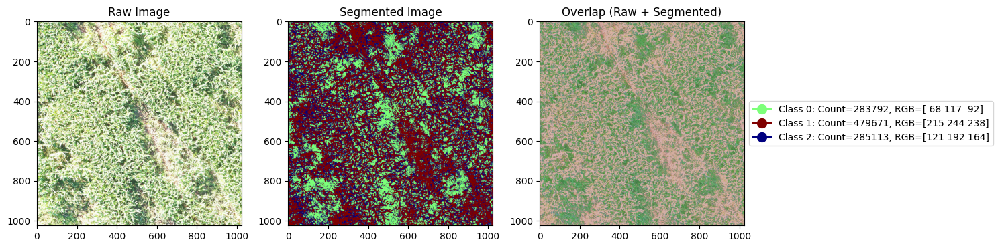

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_2_2_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 66.57146832 116.1654583   95.121361  ]
Class 0 Pixel Count: 251580
Class 1 RGB Average: [216.66259986 244.18371415 239.63402147]
Class 1 Pixel Count: 529736
Class 2 RGB Average: [122.99320138 191.30431415 165.60721395]
Class 2 Pixel Count: 267260


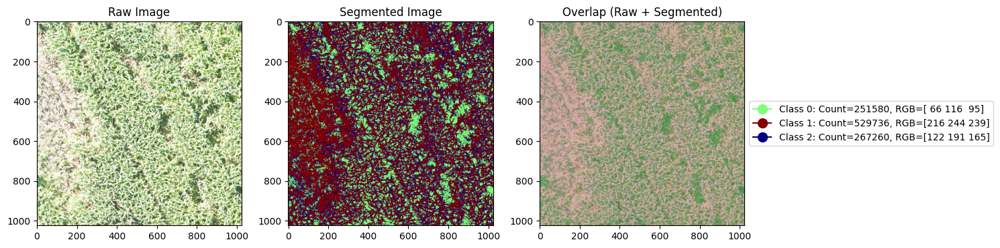

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_2_4_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 69.06938973 116.4624478   91.98369193]
Class 0 Pixel Count: 270357
Class 1 RGB Average: [216.52495059 243.66792384 238.86568081]
Class 1 Pixel Count: 513054
Class 2 RGB Average: [124.28555428 191.81173609 164.29425829]
Class 2 Pixel Count: 265165


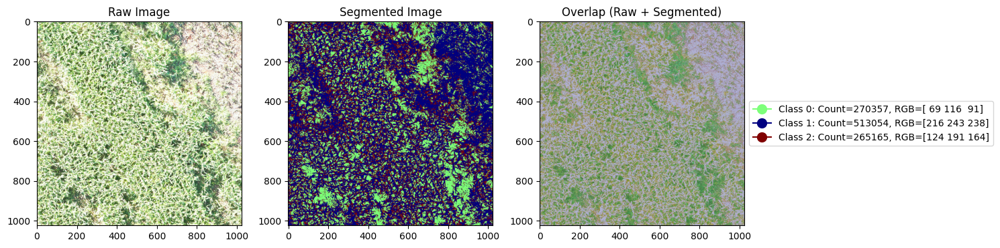

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_2_3_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 60.18490095 114.99943352  89.62214622]
Class 0 Pixel Count: 280680
Class 1 RGB Average: [213.89357004 245.29224153 238.73016455]
Class 1 Pixel Count: 476924
Class 2 RGB Average: [119.75917958 193.12397069 164.25137814]
Class 2 Pixel Count: 290972


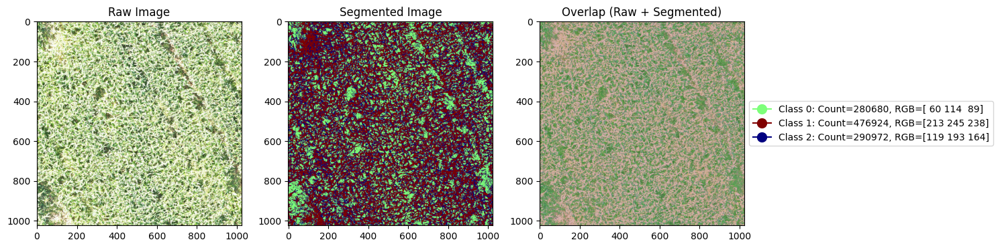

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_2_5_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 62.1525273  114.6508251   91.76713918]
Class 0 Pixel Count: 292269
Class 1 RGB Average: [214.35373598 245.43586397 238.90775622]
Class 1 Pixel Count: 473517
Class 2 RGB Average: [122.00421868 192.09940592 164.43804944]
Class 2 Pixel Count: 282790


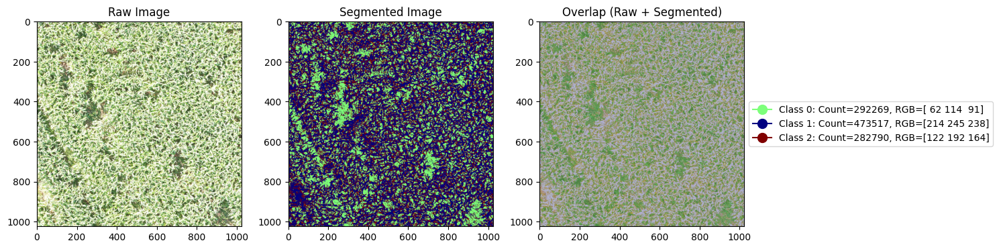

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_2_6_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 75.81228439 116.35202692  98.40702314]
Class 0 Pixel Count: 270164
Class 1 RGB Average: [216.66318681 242.64214563 239.3863159 ]
Class 1 Pixel Count: 524638
Class 2 RGB Average: [125.53747035 188.9630498  166.94392255]
Class 2 Pixel Count: 253774


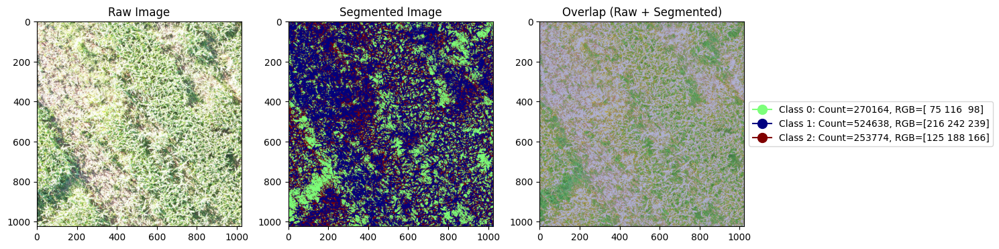

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_3_2_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 65.8335715  114.87314274  90.34558971]
Class 0 Pixel Count: 304413
Class 1 RGB Average: [215.90982561 245.28333763 239.38091546]
Class 1 Pixel Count: 473294
Class 2 RGB Average: [122.2757643  191.43385917 164.45200817]
Class 2 Pixel Count: 270869


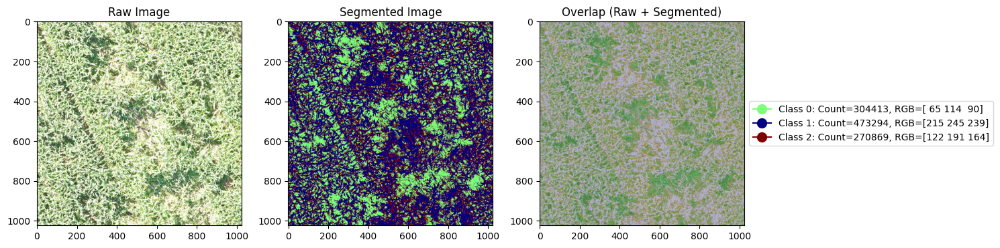

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_3_3_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 70.66459012 115.36383504  96.68330013]
Class 0 Pixel Count: 284607
Class 1 RGB Average: [215.57305152 243.31585738 239.94999228]
Class 1 Pixel Count: 505342
Class 2 RGB Average: [123.30612426 189.44104444 166.2390199 ]
Class 2 Pixel Count: 258627


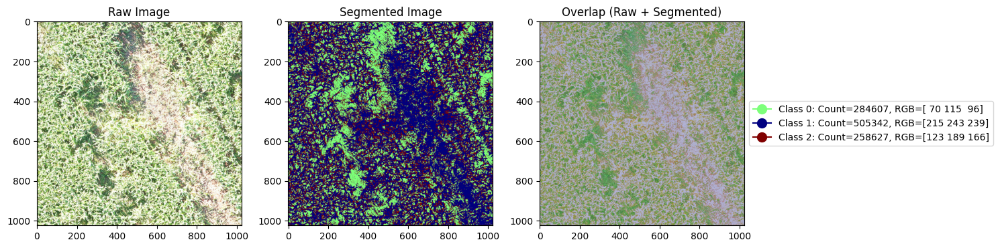

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_3_4_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 61.59723227 115.7798268   90.96284661]
Class 0 Pixel Count: 291575
Class 1 RGB Average: [214.67842684 245.43956025 239.09654378]
Class 1 Pixel Count: 470543
Class 2 RGB Average: [120.02891174 192.74286632 163.71085465]
Class 2 Pixel Count: 286458


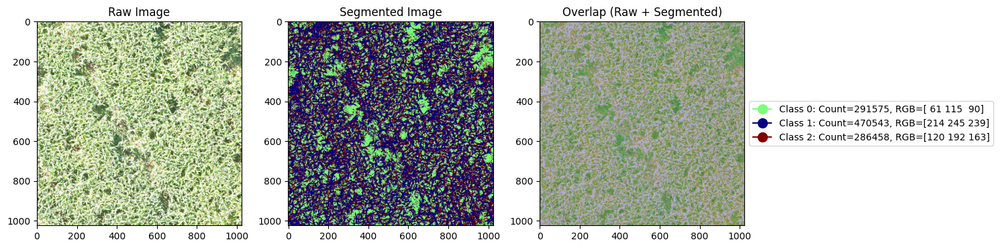

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_3_5_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 73.11996199 115.60207183  95.16828525]
Class 0 Pixel Count: 307264
Class 1 RGB Average: [216.17836463 243.52456424 238.67771073]
Class 1 Pixel Count: 475610
Class 2 RGB Average: [124.18585107 189.89667748 165.27978713]
Class 2 Pixel Count: 265702


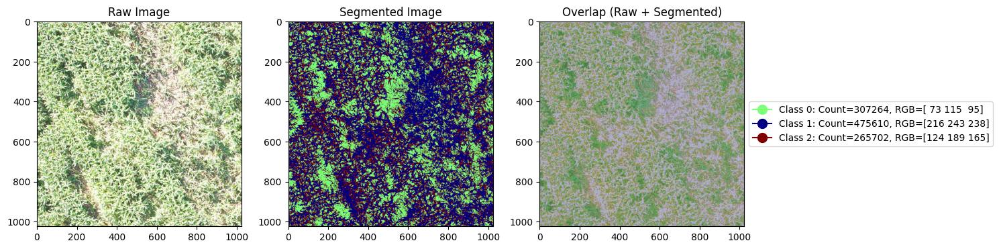

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_4_2_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 69.61420695 115.1796406   92.91901381]
Class 0 Pixel Count: 315029
Class 1 RGB Average: [216.06510079 244.51183738 239.02604159]
Class 1 Pixel Count: 471515
Class 2 RGB Average: [124.27724476 189.74532881 164.82463974]
Class 2 Pixel Count: 262032


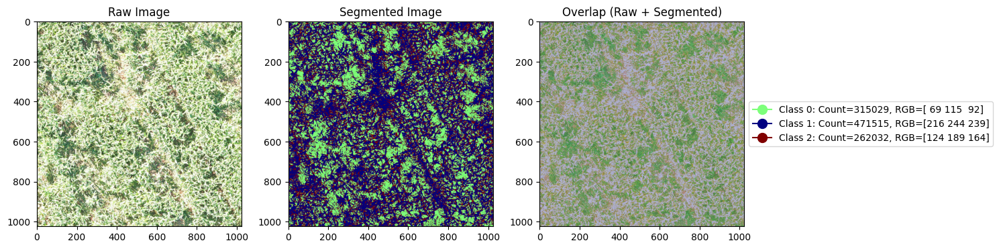

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_4_3_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 63.48520675 115.62184681  91.67947282]
Class 0 Pixel Count: 299934
Class 1 RGB Average: [215.07485103 245.51809432 238.91357644]
Class 1 Pixel Count: 469733
Class 2 RGB Average: [122.43799949 191.88335263 163.61731246]
Class 2 Pixel Count: 278909


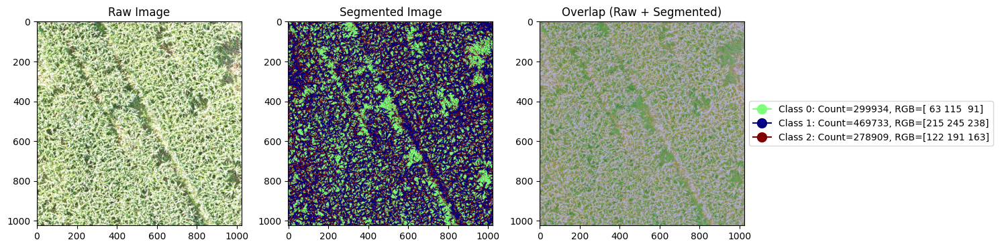

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_3_6_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 74.15264343 116.60870068  96.70492205]
Class 0 Pixel Count: 285633
Class 1 RGB Average: [215.06917352 243.29381724 239.18383454]
Class 1 Pixel Count: 499324
Class 2 RGB Average: [124.38438428 190.00355437 165.63250752]
Class 2 Pixel Count: 263619


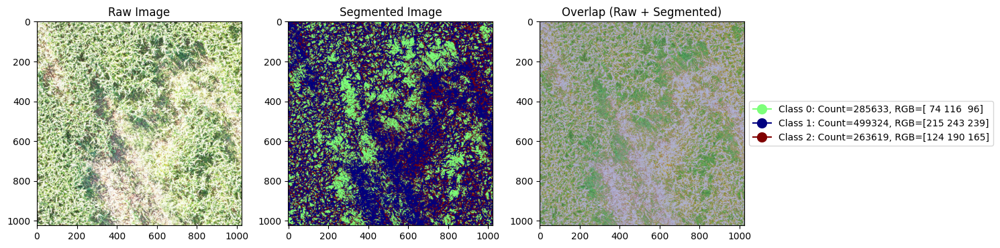

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_4_5_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 67.25811539 117.68589136  95.1686485 ]
Class 0 Pixel Count: 279623
Class 1 RGB Average: [214.36834675 244.69967205 239.21080606]
Class 1 Pixel Count: 482396
Class 2 RGB Average: [121.26401728 191.4254965  165.32989946]
Class 2 Pixel Count: 286557


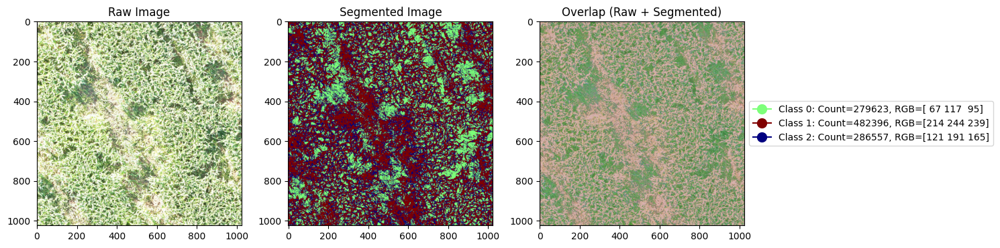

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_4_6_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 64.4347845  116.95588059  92.75594592]
Class 0 Pixel Count: 275525
Class 1 RGB Average: [215.67508537 245.71548244 239.92440775]
Class 1 Pixel Count: 488476
Class 2 RGB Average: [119.6255293  192.25958008 165.02322411]
Class 2 Pixel Count: 284575


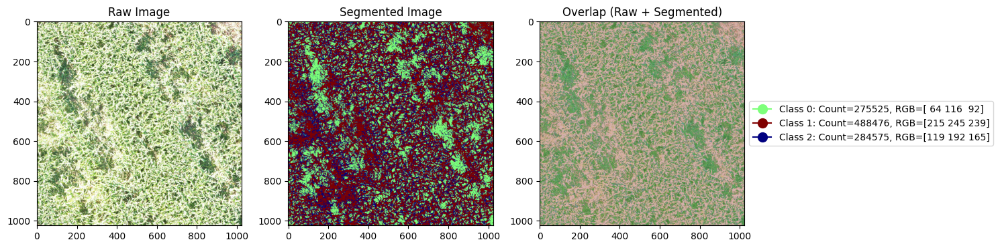

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_4_4_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 63.06450247 113.80195095  90.10840054]
Class 0 Pixel Count: 302314
Class 1 RGB Average: [215.64577007 245.42468672 239.2020139 ]
Class 1 Pixel Count: 471225
Class 2 RGB Average: [121.87935441 192.38299211 164.13624712]
Class 2 Pixel Count: 275037


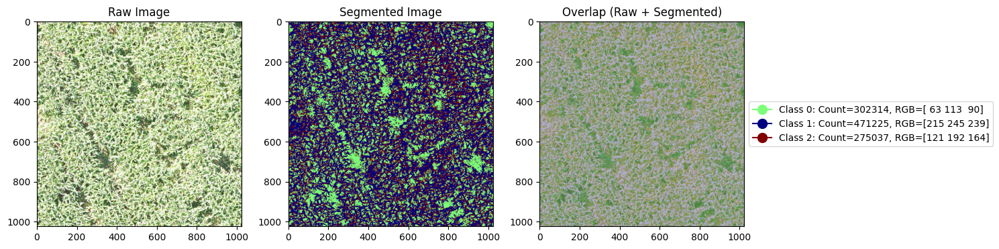

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_5_4_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 67.3682763  114.85478895  89.39835779]
Class 0 Pixel Count: 325416
Class 1 RGB Average: [216.048811   244.32102706 237.65942547]
Class 1 Pixel Count: 450800
Class 2 RGB Average: [124.78278382 191.72823102 163.39562711]
Class 2 Pixel Count: 272360


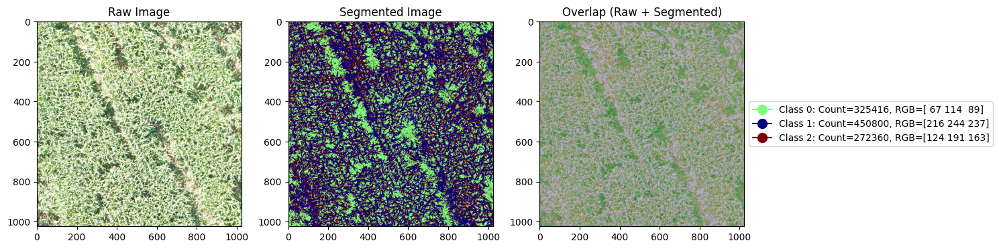

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_5_2_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 72.04694495 115.30771557  95.00762421]
Class 0 Pixel Count: 307573
Class 1 RGB Average: [216.46903462 243.99369162 239.39789223]
Class 1 Pixel Count: 482216
Class 2 RGB Average: [124.72513302 188.80066618 165.48692941]
Class 2 Pixel Count: 258787


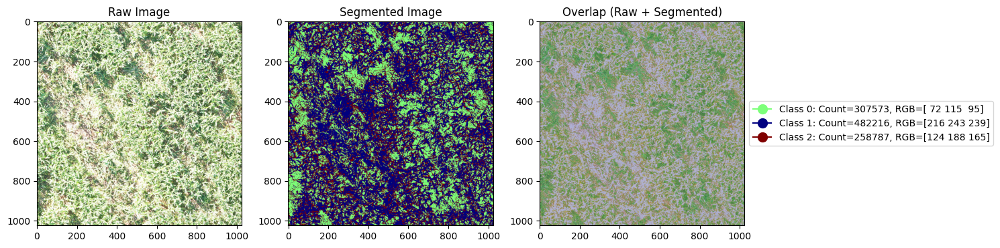

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_5_3_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 71.62430423 117.72377765  98.22959835]
Class 0 Pixel Count: 239662
Class 1 RGB Average: [216.00262275 242.22092568 239.42039861]
Class 1 Pixel Count: 554381
Class 2 RGB Average: [125.27900508 189.82564933 165.56983967]
Class 2 Pixel Count: 254533


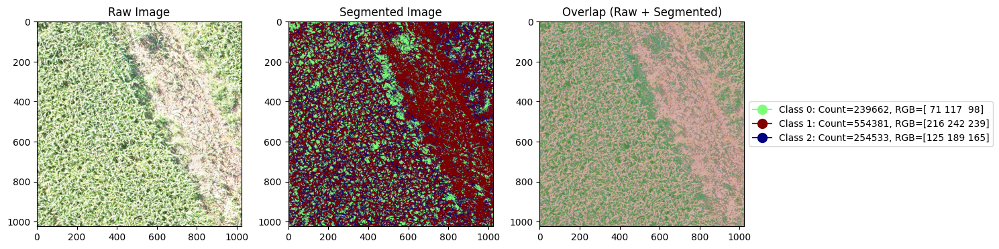

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_5_5_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 62.98242083 116.26037092  91.83761829]
Class 0 Pixel Count: 279194
Class 1 RGB Average: [214.00688417 244.94072    238.85322301]
Class 1 Pixel Count: 480668
Class 2 RGB Average: [121.51364326 192.33920766 164.33243625]
Class 2 Pixel Count: 288714


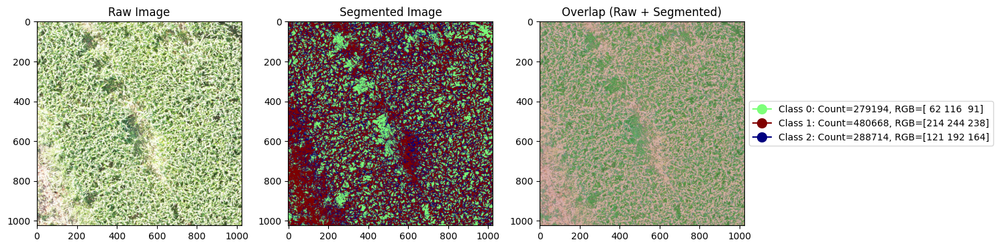

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_5_6_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 71.50968534 115.26078434  96.79659181]
Class 0 Pixel Count: 311192
Class 1 RGB Average: [213.73150824 243.16094927 238.65990763]
Class 1 Pixel Count: 473292
Class 2 RGB Average: [124.84981749 189.43712797 166.04924799]
Class 2 Pixel Count: 264092


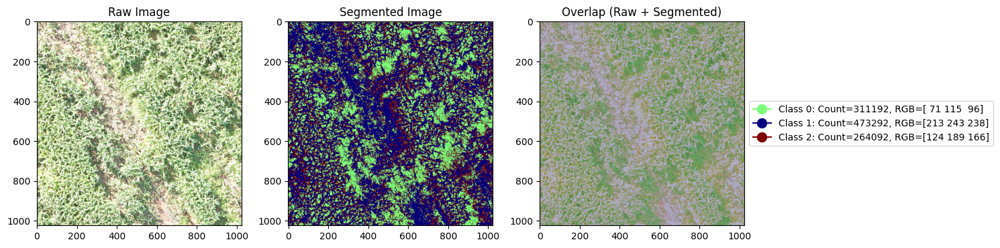

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_6_6_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 69.62491101 113.54226947  92.82124185]
Class 0 Pixel Count: 310425
Class 1 RGB Average: [215.99666458 243.63220829 239.19998841]
Class 1 Pixel Count: 483298
Class 2 RGB Average: [124.95018305 190.0662578  164.96078131]
Class 2 Pixel Count: 254853


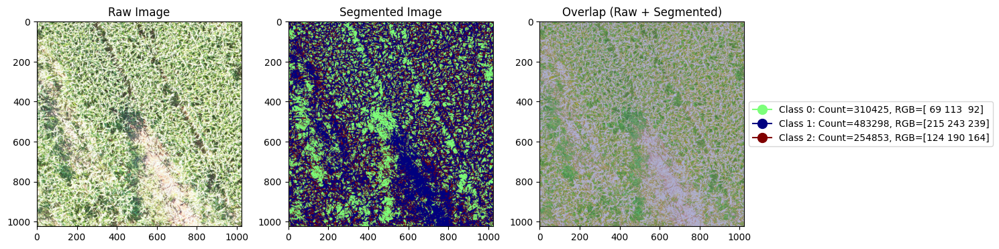

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_6_4_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 62.39207038 114.82855628  90.74916494]
Class 0 Pixel Count: 294289
Class 1 RGB Average: [214.88128024 245.45060981 239.04395555]
Class 1 Pixel Count: 470225
Class 2 RGB Average: [120.75360661 192.70499398 164.00565722]
Class 2 Pixel Count: 284062


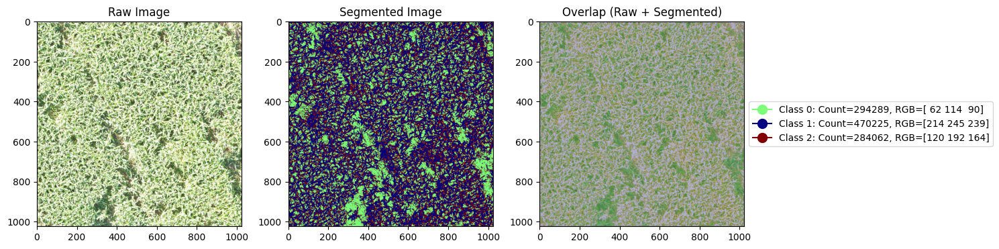

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_6_5_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 70.57065284 115.33397344  93.82430372]
Class 0 Pixel Count: 308282
Class 1 RGB Average: [215.93160337 243.97214091 239.35519974]
Class 1 Pixel Count: 477582
Class 2 RGB Average: [123.77157115 189.62200052 165.18168184]
Class 2 Pixel Count: 262712


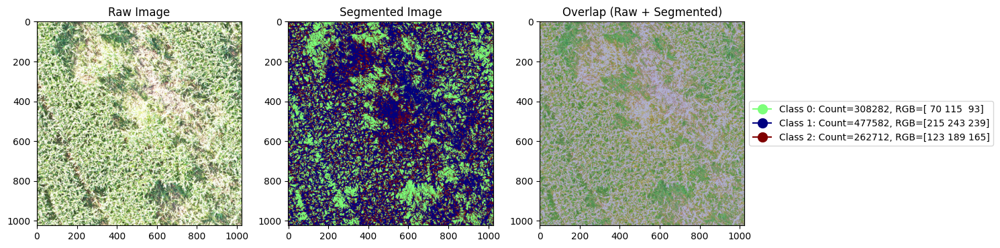

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_6_3_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 70.7735278  113.79428534  90.13911817]
Class 0 Pixel Count: 335348
Class 1 RGB Average: [216.08310022 243.40423705 237.65752239]
Class 1 Pixel Count: 456497
Class 2 RGB Average: [126.40695903 190.59465744 164.00089198]
Class 2 Pixel Count: 256731


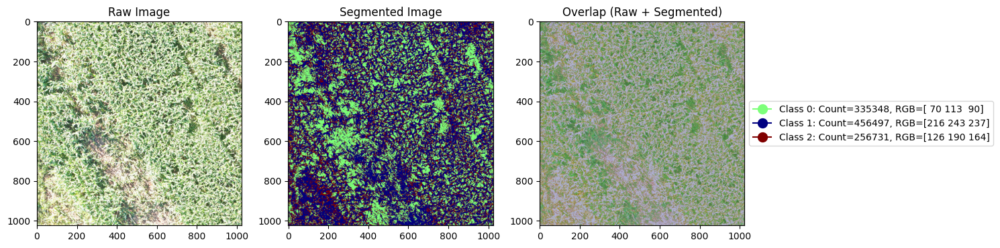

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_6_2_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 68.87358112 117.31940451  97.22699067]
Class 0 Pixel Count: 270901
Class 1 RGB Average: [214.60909364 244.32690933 239.39369777]
Class 1 Pixel Count: 496523
Class 2 RGB Average: [122.09371443 190.63129908 166.06336786]
Class 2 Pixel Count: 281152


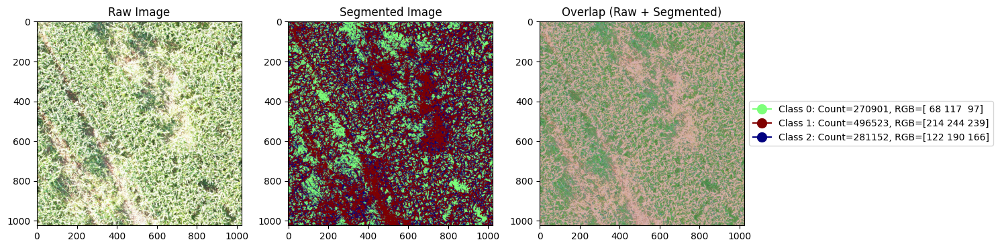

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_7_5_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 68.68201656 115.25434335  96.10119173]
Class 0 Pixel Count: 299481
Class 1 RGB Average: [215.88605764 244.55847935 240.03713955]
Class 1 Pixel Count: 479058
Class 2 RGB Average: [121.79889423 190.31280528 165.72416002]
Class 2 Pixel Count: 270037


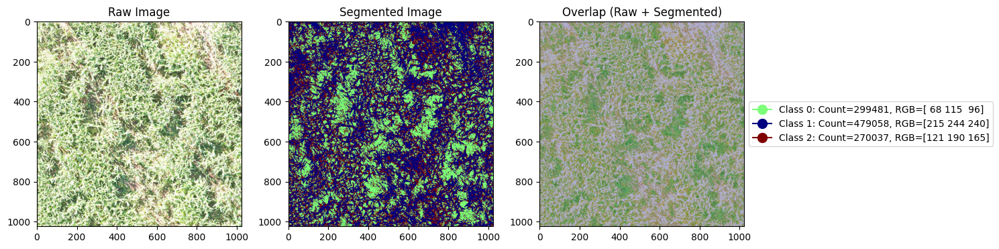

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_7_4_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 66.15921565 115.14380149  92.93546942]
Class 0 Pixel Count: 296805
Class 1 RGB Average: [214.93652442 244.51753961 239.07152676]
Class 1 Pixel Count: 478688
Class 2 RGB Average: [122.70307196 190.93194377 165.23027065]
Class 2 Pixel Count: 273083


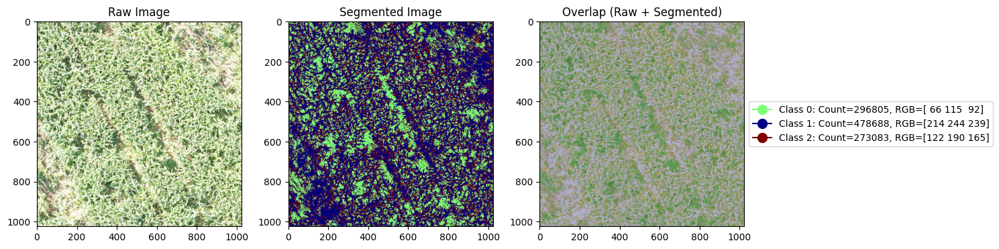

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_7_3_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Class 0 RGB Average: [ 70.42179141 117.34000137  98.82212301]
Class 0 Pixel Count: 276843
Class 1 RGB Average: [213.46742662 242.2768211  239.05309197]
Class 1 Pixel Count: 498889
Class 2 RGB Average: [123.56787395 189.11894709 166.0487568 ]
Class 2 Pixel Count: 272844


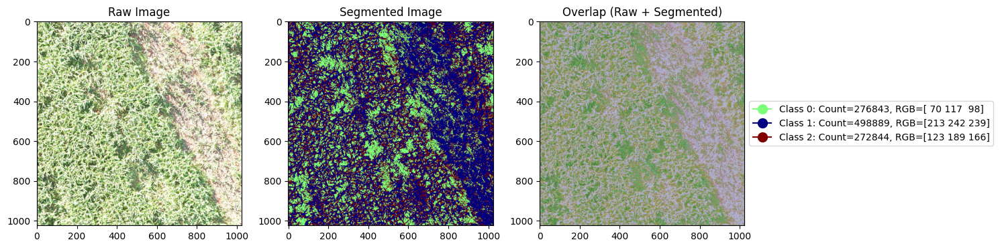

<ipython-input-26-99e80c2c74fd>:50: UserWarning: /content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/SLIC_out/orto_101media_25052023_voo8_7_6_segmented.tif is a low contrast image
  io.imsave(output_file, segmented.astype(np.uint8))


Total Number of Segments: 87
Segmented labels and RGB averages saved in the output folder.


In [ ]:
# Get a list of all .tif image files in the input folder
image_files = [f for f in os.listdir(folder_path) if f.endswith(".tif")]
total_segments = 0  # Initialize the total number of segments

# Process and classify each image
for idx, image_file in enumerate(image_files):
    image_path = os.path.join(folder_path, image_file)
    img = cv2.imread(image_path)

    # Use the first image's pixel values and classes to fit the GMM model
    if idx == 0:
        # Calculate BIC values for different numbers of components
        bic_values = calculate_bic(img, max_components=max_components)

        # Suggest the best number of components based on BIC
        best_components = suggest_best_components(bic_values)
        print(f"Best number of components for {image_file}: {best_components}")

        # Fit the GMM model with the best number of components
        gmm_model = fit_gmm_model(img, n_components=best_components)

    # Export GMM components as separate rasters
    export_gmm_components(gmm_model, image_file, output_folder)

    # Perform SLIC segmentation
    slic_segments = slic(img, n_segments=n_segments, compactness=compactness)

    # Process the image using the fitted GMM model
    segmented = process_image(img, gmm_model)

    # Compute RGB average values and pixel counts for each class
    rgb_averages, pixel_counts = compute_class_rgb_averages_and_counts(img, segmented, n_components=best_components)

    # Calculate the total number of segments
    total_segments += best_components  # Add the number of segments for the current image

    # Print RGB average values, pixel counts, and the total number of segments
    for i, (rgb_average, pixel_count) in enumerate(zip(rgb_averages, pixel_counts)):
        print(f"Class {i} RGB Average: {rgb_average}")
        print(f"Class {i} Pixel Count: {pixel_count}")

    # Define legend labels based on class statistics
    legend_labels = [f"Class {i}: Count={pixel_counts[i]}, RGB={rgb_averages[i].astype(int)}" for i in range(best_components)]

    # Plot the raw image, segmented image, and overlapped image
    plot_raw_segmented_overlap(img, segmented, legend_labels)

    # Save segmented labels as a separate raster in the output folder
    output_file = os.path.join(output_folder, f"{os.path.splitext(image_file)[0]}_segmented.tif")
    io.imsave(output_file, segmented.astype(np.uint8))

print(f"Total Number of Segments: {total_segments}")
print("Segmented labels and RGB averages saved in the output folder.")

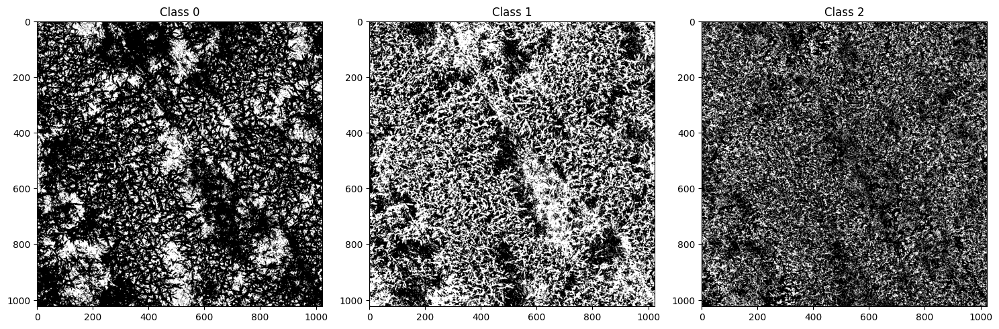

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the segmented image for the first image
segmented_image = cv2.imread('/content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/GMM_out/orto_101media_25052023_voo8_2_2_segmented.tif', cv2.IMREAD_GRAYSCALE)

# Find the unique class labels in the segmented image
unique_labels = np.unique(segmented_image)

# Create a subplot grid for displaying each class
num_rows = 1
num_cols = len(unique_labels)
plt.figure(figsize=(15, 5))

# Display each class as an image
for i, label in enumerate(unique_labels):
    class_image = np.zeros_like(segmented_image)
    class_image[segmented_image == label] = 255

    plt.subplot(num_rows, num_cols, i + 1)
    plt.imshow(class_image, cmap='gray')
    plt.title(f"Class {label}")

plt.tight_layout()
plt.show()


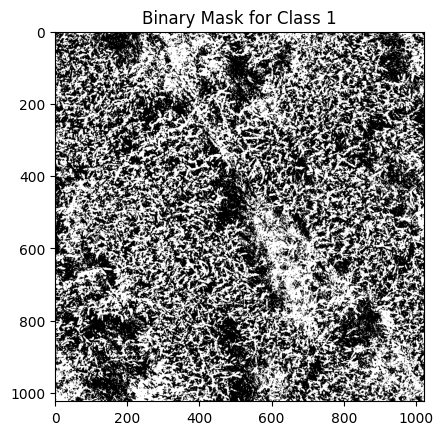

In [ ]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

# Load the segmented image for the first image
segmented_image = cv2.imread('/content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/GMM_out/orto_101media_25052023_voo8_2_2_segmented.tif', cv2.IMREAD_GRAYSCALE)

# Find the unique class labels in the segmented image
unique_labels = np.unique(segmented_image)

# Create a DataFrame to store binary masks
binary_masks = pd.DataFrame()

# Choose a specific class label (replace with your desired label)
desired_label = 1  # Replace with the class label you want to select

# Create a binary mask for the desired class
class_mask = (segmented_image == desired_label).astype(np.uint8)

# Add the binary mask to the DataFrame
binary_masks[f'Class_{desired_label}_Mask'] = class_mask.flatten()

# Create a placeholder target variable 'y' (replace with your actual target variable)
# Example: For binary classification, you can create random binary labels
y = np.random.randint(0, 2, size=binary_masks.shape[0])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(binary_masks, y, test_size=0.2, random_state=0)

# Create and train a Random Forest Classifier
random_forest = RandomForestClassifier(n_estimators=100, random_state=0)
random_forest.fit(X_train, y_train)

# Predict using the trained model
y_pred = random_forest.predict(X_test)

# Evaluate the model (replace with your own evaluation code)
# Example: accuracy = accuracy_score(y_test, y_pred)
# Example: confusion_matrix = confusion_matrix(y_test, y_pred)
# Example: print(f'Accuracy: {accuracy}, Confusion Matrix:\n{confusion_matrix}')

# Visualize the binary mask
plt.imshow(class_mask, cmap='gray')
plt.title(f"Binary Mask for Class {desired_label}")
plt.show()


In [ ]:
label_output_folder = '/content/drive/MyDrive/Embrapa_Milho_Javali/dataset_2/label_out/'

# Get a list of image files in the folder
image_files = os.listdir(folder_path)

# Specify the class number you want to extract and save
desired_class = 1  # Change this to the class number you want to extract

# Loop through each image file
for idx, image_file in enumerate(image_files):
    image_path = os.path.join(folder_path, image_file)
    img = cv2.imread(image_path)

    # Save component 0 mask to the label output folder
    label_output_file = os.path.join(label_output_folder, f"{os.path.splitext(image_file)[0]}_component_2_mask.tif")
    io.imsave(label_output_file, component_0_mask * 255)  # Saving as an 8-bit image

    # Extract and save the desired class as a separate raster
    class_mask = segmented == desired_class
    class_img = np.zeros_like(img)
    class_img[class_mask] = img[class_mask]

    # Save the class as a separate raster
    output_file = os.path.join(output_folder, f"{os.path.splitext(image_file)[0]}_class_{desired_class}.tif")
    io.imsave(output_file, class_img.astype(np.uint8))


KeyboardInterrupt: ignored

In [ ]:
# Get a list of all .tif image files in the input folder
image_files = [f for f in os.listdir(folder_path) if f.endswith(".tif")]

# Process and classify each image
for idx, image_file in enumerate(image_files):
    image_path = os.path.join(folder_path, image_file)
    img = cv2.imread(image_path)

    # Use the first image's pixel values and classes to fit the GMM model
    if idx == 0:
        # Calculate BIC values for different numbers of components
        bic_values = calculate_bic(img, max_components=max_components)

        # Suggest the best number of components based on BIC
        best_components = suggest_best_components(bic_values)
        print(f"Best number of components for {image_file}: {best_components}")

        # Fit the GMM model with the best number of components
        gmm_model = fit_gmm_model(img, n_components=best_components)

        # Extract class labels from the segmented image of the first image
        first_image_segmented = process_image(img, gmm_model)
        first_image_class_labels = np.unique(first_image_segmented)

        # Export GMM components as separate rasters
        export_gmm_components(gmm_model, image_file, output_folder)

    # Process the image using the fitted GMM model
    segmented = process_image(img, gmm_model)

    # Extract component 0 mask
    component_1_mask = (segmented == 1).astype(np.uint8)

    # Save component 0 mask to the label output folder
    label_output_file = os.path.join(label_output_folder, f"{os.path.splitext(image_file)[0]}_component_1_mask.tif")
    io.imsave(label_output_file, component_1_mask * 255)  # Saving as a 8-bit image


    # Export each class as a separate raster
    for class_label in first_image_class_labels:
        class_mask = segmented == class_label
        class_img = np.zeros_like(img)
        class_img[class_mask] = img[class_mask]
        output_file = os.path.join(output_folder, f"{os.path.splitext(image_file)[0]}_class_{class_label}.tif")
        io.imsave(output_file, class_img.astype(np.uint8))

Best number of components for orto_101media_25052023_voo8_2_2.tif: 3


#backup code
```python
# Function to plot the raw image, segmented image, and overlap
def plot_raw_segmented_overlap(raw_image, segmented, legend_labels):
    plt.figure(figsize=(15, 5))

    # Plot the raw image
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(raw_image, cv2.COLOR_BGR2RGB))
    plt.title("Raw Image")

    # Ensure the segmented image has the same dimensions as the raw image
    if raw_image.shape[:2] != segmented.shape[:2]:
        segmented = cv2.resize(segmented, (raw_image.shape[1], raw_image.shape[0]), interpolation=cv2.INTER_NEAREST)

    # Apply a colormap to the segmented image
    custom_cmap = reorder_colormap(segmented, n_components=len(legend_labels))
    segmented_rgb = custom_cmap(segmented)

    # Convert segmented image to uint8 data type
    segmented_rgb = (segmented_rgb * 255).astype(np.uint8)

    # Plot the segmented image
    plt.subplot(1, 3, 2)
    plt.imshow(segmented_rgb)
    plt.title("Segmented Image")

    # Convert segmented image to BGR format for compatibility
    segmented_bgr = cv2.cvtColor(segmented_rgb, cv2.COLOR_RGB2BGR)

    # Create an overlapped image by manually blending the raw and segmented images
    alpha = 0.7  # Adjust the transparency level
    overlapped_image = (alpha * raw_image + (1 - alpha) * segmented_bgr).astype(np.uint8)

    # Display the overlapped image
    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(overlapped_image, cv2.COLOR_BGR2RGB))
    plt.title("Overlap (Raw + Segmented)")

    plt.tight_layout()
    plt.show()
```